In [2]:
import sys
import yaml
import os
import pandas as pd
from sklearn.datasets import make_classification
import matplotlib.pyplot as plt
import seaborn as sns
sys.path.append(os.path.abspath(".."))

KeyboardInterrupt: 

In [2]:

# Импортируем функцию для определения корня проекта
sys.path.append(os.path.abspath("../scripts"))
from auxiliary_functions import get_project_root

# Добавляем корень проекта в sys.path
sys.path.append(get_project_root())

from scripts.auxiliary_functions import get_project_paths
from scripts.auxiliary_functions import plot_training_results

In [3]:
project_root = get_project_root()
params_path = os.path.join(project_root, "params.yaml")

with open(params_path, "r") as f:
    params = yaml.safe_load(f)
    paths = get_project_paths()

# Часть 1. Эмпирический анализ влияния функций активации и гиперпараметров на производительность нейронных сетей

1. Введение
Цель: Исследовать влияние функций активации, инициализаций, регуляризаций и других гиперпараметров на производительность моделей регрессии и классификации.

Методология: Использовался Optuna для автоматического подбора гиперпараметров. Проведено ~90 экспериментов с различными комбинациями активаций, инициализаторов, регуляризаторов и типов задач. Анализ проводился по графикам сходимости и финальным метрикам (MAE, RMSE, Accuracy и др.).


## Загружаем сгенерированные данные для идеального теста по регрессии

2. Регрессия
2.1. Описание данных
Признаки содержат нелинейные зависимости и коррелированные комбинации.

Целевая переменная: сумма синусоид с добавленным шумом.

x1 = np.random.normal(0, 1, n_samples)
x2 = np.random.normal(0, 1, n_samples)
x3 = np.random.uniform(1, 2, n_samples)  
x4 = np.random.normal(0, 1, n_samples)
x5 = np.random.normal(0, 1, n_samples)
x6 = np.random.normal(0, 1, n_samples)

x7 = x1 + x2
x8 = np.log(x3)
x9 = x7 * np.sin(x6)
x10 = 20 * x1 + x2 / x3

X = np.stack([x1, x2, x3, x4, x5, x6, x7, x8, x9, x10], axis=1)


y = np.sin(X[:, 0]) + np.sin(X[:, 1]) + np.random.normal(0, noise_std, n_samples)

In [1]:
syntetic_df = pd.read_csv(paths['raw_dir']/"synthetic_regression.csv")

NameError: name 'pd' is not defined

In [5]:
syntetic_df

,Unnamed: 0,x1,x2,x3,x4,x5,x6,x7,x8,x9,x10,y
0,0,0.496714,1.399355,1.407106,0.573128,-0.164335,0.486185,1.896070,0.341535,0.885950,10.928775,1.771709
1,1,-0.138264,0.924634,1.066010,-1.785866,0.212093,-1.949372,0.786369,0.063923,-0.730688,-1.897908,0.634759
2,2,0.647689,0.059630,1.348821,-0.359630,-0.993359,-2.050357,0.707319,0.299231,-0.627532,12.997980,0.713952
3,3,1.523030,-0.646937,1.110998,0.301107,-1.015879,0.739180,0.876093,0.105259,0.590209,29.878295,0.331178
4,4,-0.234153,0.698223,1.808235,0.183835,-1.388543,0.507020,0.464070,0.592351,0.225341,-4.296932,0.440361
...,...,...,...,...,...,...,...,...,...,...,...,...
995,995,-0.281100,1.070150,1.342645,-0.412414,-0.399878,-2.506572,0.789050,0.294642,-0.468060,-4.824960,0.554471
996,996,1.797687,-0.026521,1.864659,0.257199,-0.114641,0.297462,1.771165,0.623078,0.519119,35.939507,1.036858
997,997,0.640843,-0.881875,1.154925,-0.240665,0.264268,0.139498,-0.241032,0.144036,-0.033514,12.053280,-0.234787
998,998,-0.571179,-0.163067,1.082737,0.007880,-0.150117,-0.284837,-0.734246,0.079492,0.206324,-11.574186,-0.722990


### Сравнение резульаттов


=== Activation: RELU ===



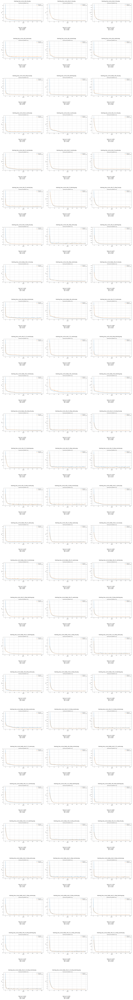


=== Activation: ELU ===



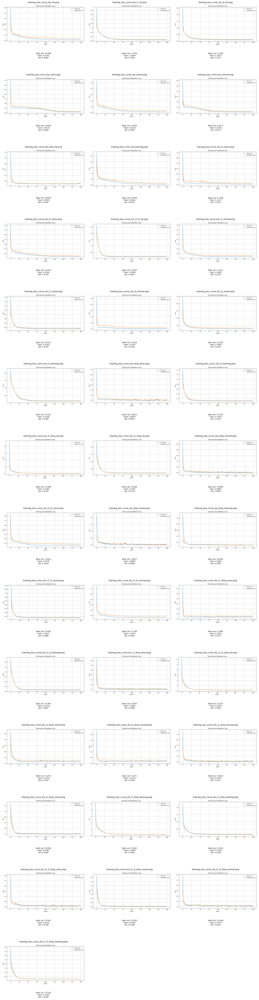


=== Activation: MISH ===



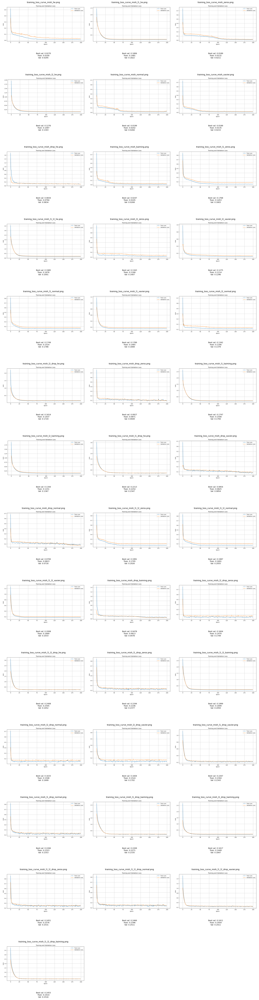


=== Activation: TANH ===



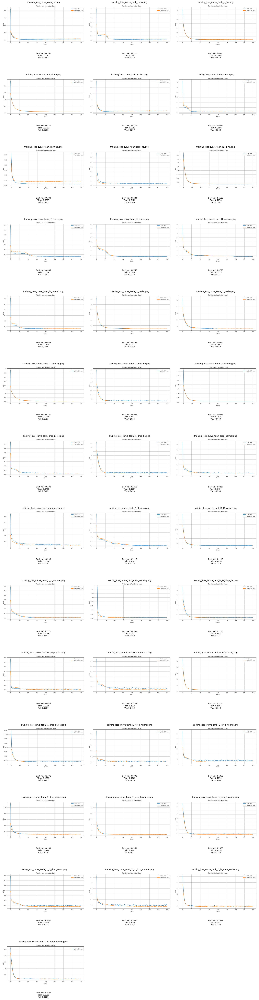


=== Activation: SWISH ===



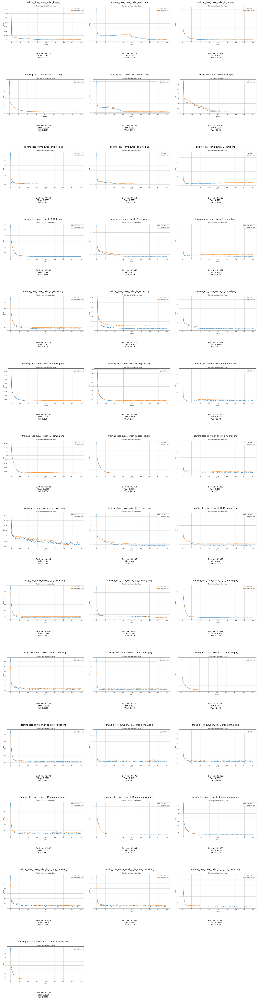


=== Activation: SIGMOID ===



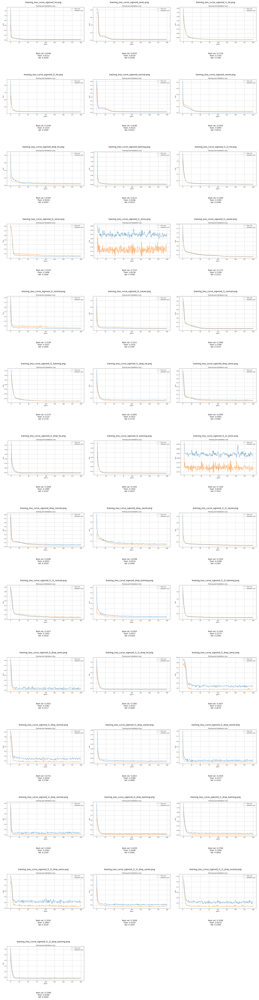

In [6]:
# Без Class:
plot_training_results(class_mode=False)


Лучшие данные согласно optuna

{
    "best_params": {
        "activation": "swish",
        "dropout": 0.0,
        "l1": 0.0,
        "l2": 0.0,
        "initializer": "zeros",
        "loss_fn": "mse",
        "hidden_size": 32,
        "batch_size": 64
    },
    "best_val_loss": 0.01870121620595455
}

# Общие наюлюдения(++ - отлично работает, + скорее в плюс работает, +-/ - непонтяно, - скорее в минус работает, -- однозначно портит:
L1, L2 - везде показали себя как и должны, т.е качественно борятся с переобучением/мультиколлинеарностью

- Relu/Elu/Leak Relu
  kaiming, He ++
  xavier - +/-
  dropout (drop), batch normalization (normal) -
  zeros --
  
- tanh
  zeros +
  xavier +
  kaiming, He -
  drop, normal -

- Mish (сложилось впечатление что функция самостоятельно спраивалась с мультиколлинератностью, т.е ей не понадобились регуляризаторы)
  kaiming, He ++
  xavier +/-
  drop, normal -
  zeros --

- Swish (сложилось впечатление что функция самостоятельно спраивалась с мультиколлинератностью, т.е ей не понадобились регуляризаторы)
  kaiming, He ++
  xavier +/-
  drop, normal -
  zeros --

- Sigmoid
  kaiming, He ++
  xavier +
  drop, normal -
  zeros(без drop) ---
  zeros(c drop) +/- (веротяно редкий случай когда drop все же помог)

| Activation         | Init        | Dropout | BatchNorm | L1/L2 | Итог | Комментарий                                 |
| ------------------ | ----------- | ------- | --------- | ----- | ---- | ------------------------------------------- |
| ReLU/ELU/LeakyReLU | Kaiming, He | ✗       | ✗         | ✓     | ++   | Оптимальны с He/Kaiming, не требуют Drop/BN |
| ReLU               | Xavier      | ✗       | ✗         | ✓     | +    | Средние результаты                          |
| Tanh               | Xavier      | ✓       | ✗         | ✗     | +    | Единственный случай, когда Dropout помог    |
| Mish               | Kaiming/He  | ✗       | ✗         | ✗     | ++   | Отлично справляется без регуляризации       |
| Swish              | Kaiming/He  | ✗       | ✗         | ✗     | ++   | Аналогично Mish                             |
| Sigmoid            | He          | ✗       | ✗         | ✓     | ++   | При drop + zeros — нестабильно              |


### 2.3. Выводы
Лучшие результаты: Mish и Swish без регуляризаторов при инициализации Kaiming/He.

Регуляризация: L1 и L2 полезны почти везде. Dropout и BatchNorm — избыточны или вредны в контексте регрессии.

Инициализаторы: Kaiming/He — наилучшие для большинства активаций. Xavier — средние результаты. Zeros — приводит к провалу обучения почти всегда.

## 3. Классификация

In [ ]:
# Генерация данных: 10 признаков, 2 класса, 5 информативных, 2 редундантных (зависимых), 3 шумовых
X, y = make_classification(
    n_samples=1000,
    n_features=10,
    n_informative=5,
    n_redundant=2,
    n_repeated=0,
    n_classes=2,
    random_state=42
)

X = pd.DataFrame(X, columns=[f"feature_{i}" for i in range(X.shape[1])])
y = pd.Series(y, name="target")

# Объединяем X и y
new = pd.concat([X, y], axis=1)

# Сохраняем в CSV
new.to_csv(paths['raw_dir']/"synthetic_dataset.csv", index=False)


In [7]:
class_data = pd.read_csv(paths['raw_dir']/"synthetic_dataset.csv")


=== Activation: RELU ===



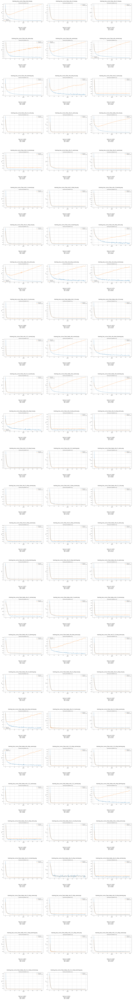


=== Activation: SWISH ===



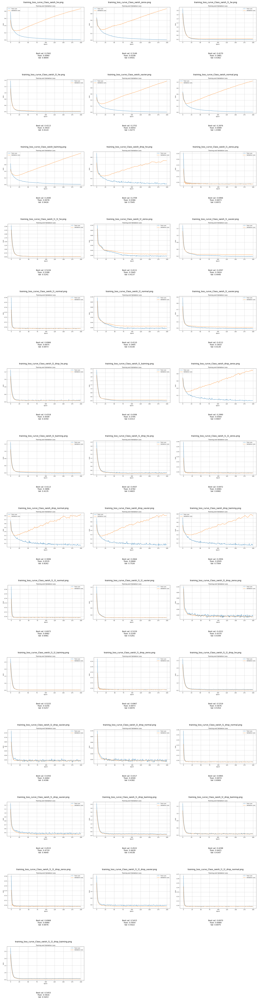


=== Activation: TANH ===



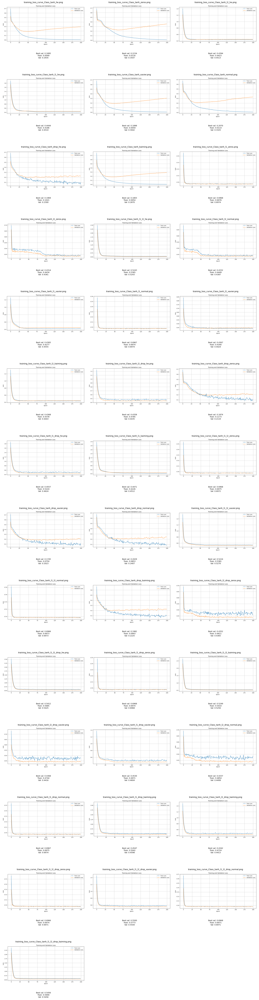


=== Activation: SIGMOID ===



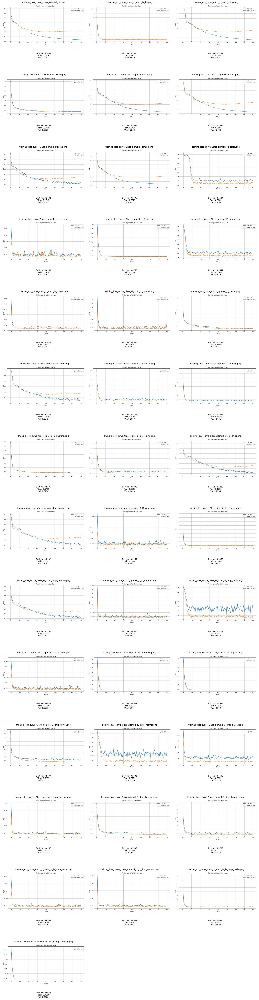


=== Activation: ELU ===



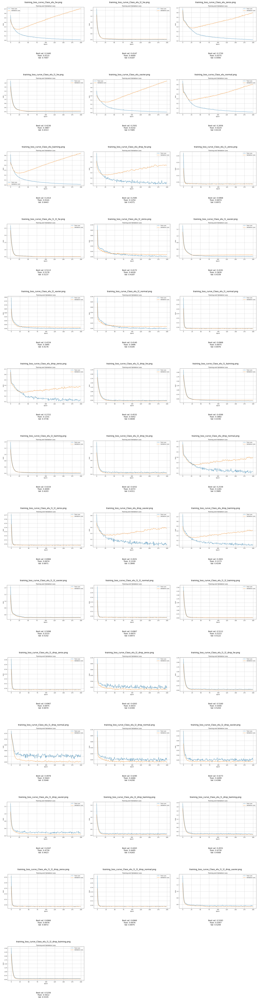


=== Activation: MISH ===



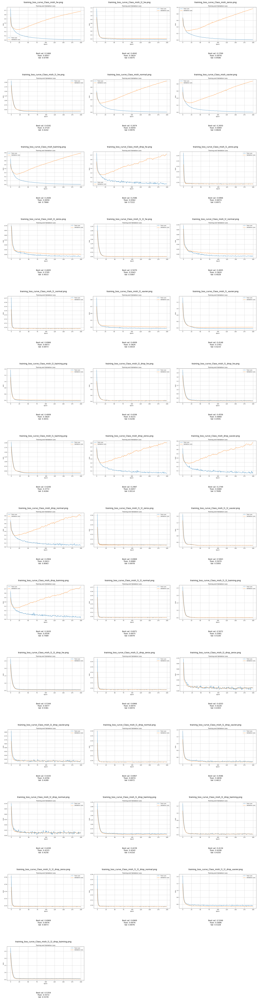

In [8]:

# С Class:
plot_training_results(class_mode=True)

Лучшие данные согласно optuna

{
    "best_params": {
        "activation": "tanh",
        "dropout": 0.2,
        "l1": 0.0,
        "l2": 0.0,
        "initializer": "xavier",
        "loss_fn": "BCE",
        "hidden_size": 32,
        "batch_size": 64
    },
    "best_val_loss": 0.24417845904827118
}

### Таблица исследований

In [26]:
table = pd.read_csv(paths['raw_dir']/"runs.csv")
# Общие параметры
common_columns = ["model_name_tag", "activation", "dropout", "hidden_size", "initializer", "l1", "l2", "loss_fn"]

In [27]:

# Для регрессии
regression_columns = common_columns + ["best_val_loss", "train_loss", "val_loss"]
regression_df = table[
    ~table["model_name_tag"].str.contains("Class", na=False)
][regression_columns]

In [28]:
regression_df

,model_name_tag,activation,dropout,hidden_size,initializer,l1,l2,loss_fn,best_val_loss,train_loss,val_loss
0,NaN,elu,0.0,32.0,zeros,0.00,0.00,mse,NaN,NaN,0.029350
1,elu_zeros,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.021752,0.026623
2,NaN,tanh,0.0,32.0,kaiming,0.01,0.01,mse,NaN,NaN,0.040148
3,tanh_l1_l2_kaiming,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.106357,0.114288
4,NaN,sigmoid,0.2,32.0,he,0.00,0.01,mse,NaN,NaN,0.147396
...,...,...,...,...,...,...,...,...,...,...,...
1113,NaN,sigmoid,0.0,32.0,xavier,0.00,0.01,BCE,NaN,NaN,NaN
1115,NaN,sigmoid,0.2,32.0,normal,0.01,0.00,BCE,NaN,NaN,NaN
1117,NaN,relu,0.0,32.0,zeros,0.00,0.00,BCE,NaN,NaN,NaN
1119,NaN,mish,0.2,32.0,kaiming,0.00,0.01,BCE,NaN,NaN,NaN


In [29]:
# Для классификации
classification_columns = common_columns + ["best_val_loss", "train_loss", "val_loss", "val_accuracy", "val_bce_loss"]
classification_df = table[
    table["model_name_tag"].str.contains("Class", na=False)
][classification_columns]


In [30]:
classification_df

,model_name_tag,activation,dropout,hidden_size,initializer,l1,l2,loss_fn,best_val_loss,train_loss,val_loss,val_accuracy,val_bce_loss
562,Class_elu_zeros,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.027520,0.593971,NaN,NaN
564,Class_tanh_l1_l2_kaiming,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.541048,0.525613,NaN,NaN
566,Class_sigmoid_l2_drop_he,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.606522,0.580019,NaN,NaN
568,Class_elu_drop_zeros,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.133056,0.373578,NaN,NaN
570,Class_mish_l1_l2_normal,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.697544,0.697884,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1112,Class_mish_l1_normal,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.697313,0.697335,NaN,NaN
1114,Class_sigmoid_l2_xavier,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.580156,0.568219,NaN,NaN
1116,Class_sigmoid_l1_drop_normal,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.701289,0.697537,NaN,NaN
1118,Class_relu_zeros,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.311015,0.560641,NaN,NaN


# Общие наюлюдения(++ - отлично работает, + скорее в плюс работает, +-/ - непонтяно, - скорее в минус работает, -- однозначно портит:
L1, L2 - везде показали себя как и должны, т.е качественно борятся с переобучением/мультиколлинеарностью

Тольк оодна из функций смогла справиться с мультиколинеарностью без регуляризаторов, но с помощью dropи это функция tanh.
А при использовании регуляризаторов любые комбинации параметров давали схожие результаты. Поэтому всем можно ставить +


| Activation      | Init    | Dropout | BatchNorm | L1/L2 | Итог | Комментарий                                                    |
| --------------- | ------- | ------- | --------- | ----- | ---- | -------------------------------------------------------------- |
| Все (при L1/L2) | Любая   | ✗/✓     | ✗         | ✓     | +    | Любые комбинации работали стабильно                            |
| Tanh            | Xavier  | ✓       | ✗         | ✗     | ++   | Удалось справиться без L1/L2, но с Dropout                     |
| Mish, Swish     | Kaiming | ✗       | ✗         | ✗     | +    | Работают хорошо, но не превосходят комбинации с регуляризацией |


### 3.3. Выводы
Регуляризация (L1/L2) снова доказала свою пользу.

Dropout оказался полезен в отдельных случаях (особенно с tanh).

Mish и Swish не дали преимущества без регуляризации в классификации, как это было в регрессии.



### 4. Рекомендации и эвристики
4.1. Регрессия
Если данные содержат нелинейности и шум — предпочтительны Mish или Swish без Dropout, но с инициализацией Kaiming.

При использовании tanh — использовать Xavier и Dropout.

Dropout и BatchNorm скорее вредят(если данные не располагают к их использованию).

4.2. Классификация
Все функции активации работают хорошо при наличии L1/L2.
Если хочется избежать регуляризации — tanh с Dropout может быть рабочим компромиссом.

Mish и Swish работают стабильно, но не дают существенного преимущества при наличии регуляризаторов.

| Назначение    | Функция потерь / Инициализатор / Активация | Когда применять                                                 | Тип задачи               | Пример данных                   |
| ------------- | ------------------------------------------ | --------------------------------------------------------------- | ------------------------ | ------------------------------- |
| **Регрессия** | `MSELoss` (Mean Squared Error)             | Основной выбор при нормальном распределении ошибок              | Регрессия                | Цена жилья, прогноз температуры |
|               | `L1Loss` (MAE)                             | Более устойчив к выбросам                                       | Регрессия                | Доход, спрос                    |
|               | `HuberLoss`                                | Компромисс между MSE и MAE                                      | Регрессия                | Временные ряды                  |
|               | `Xavier` (Glorot) init                     | При использовании `tanh`, `sigmoid`                             | Любая (обычно регрессия) | Любые числовые признаки         |
|               | `ReLU`                                     | Стандартная активация для большинства задач с непрерывной целью | Регрессия                | Прогнозы, числовые данные       |
|               | `Tanh`                                     | Для нормализованных данных                                      | Регрессия                | Временные ряды                  |
|               | `Sigmoid`                                  | Для сжимающих значений в пределах \[0, 1]                       | Регрессия (редко)        | Бинарные данные                 |



| **Классификация**  | **Функция потерь**  | Когда применять                                      | Тип задачи               | Пример данных                    |
| ------------------ | ------------------- | ---------------------------------------------------- | ------------------------ | -------------------------------- |
|                    | `CrossEntropyLoss`  | Стандарт для многоклассовой классификации            | Классификация            | Текст, категории товаров         |
|                    | `BCEWithLogitsLoss` | Для бинарной классификации с логитами (до `sigmoid`) | Классификация            | Да/нет, 0/1                      |
|                    | `LabelSmoothing`    | При переобучении на чёткие метки                     | Классификация            | NLP, анти-оверфит                |
| **Инициализаторы** | `Kaiming` (He init) | При использовании `ReLU`, `LeakyReLU`                | Классификация            | Любые                            |
|                    | `ReLU`              | Для глубоких сетей, быстрые вычисления               | Классификация            | Текстовые, изображения           |
|                    | `LeakyReLU`         | Если `ReLU` даёт "мёртвые нейроны"                   | Классификация            | Задачи с пропущенными значениями |
| **Активации**      | `Sigmoid`           | Для выхода в диапазоне \[0, 1], часто с BCE          | Классификация (бинарная) | Бинарная классификация           |


| **Изображения**    | **Функция потерь**        | Когда применять                                     | Тип задачи              | Пример данных            |
| ------------------ | ------------------------- | --------------------------------------------------- | ----------------------- | ------------------------ |
|                    | `CrossEntropyLoss`        | Для классификации изображений                       | Классификация           | MNIST, CIFAR             |
|                    | `Dice Loss`, `Focal Loss` | Сегментация и дисбаланс классов                     | Классификация (segm.)   | Медицинские снимки       |
|                    | `MSE`, `Perceptual Loss`  | Для восстановления/генерации                        | Генерация, автоэнкодеры | SRGAN, Autoencoder       |
| **Инициализаторы** | `Kaiming` init            | Для CNN, особенно с ReLU                            | Изображения             | CNN, ResNet              |
| **Активации**      | `ReLU`                    | Часто используется в сверточных сетях               | Изображения             | Обработка изображений    |
|                    | `LeakyReLU`               | Альтернатива `ReLU` с учётом отрицательных значений | Изображения             | Задачи с шумными данными |


| Активация | Задача         | Когда использовать                                                                                  |
| --------- | -------------- | --------------------------------------------------------------------------------------------------- |
| **Swish** | Классификация  | Для глубоких нейросетей, где требуется плавность градиентов, например, многоклассовая классификация |
|           | Регрессия      | Для предотвращения исчезающих градиентов и улучшения сходимости моделей                             |
|           | Изображения    | В сверточных нейросетях для повышения производительности в компьютерном зрении                      |
| **Mish**  | Классификация  | Подходит для глубоких нейросетей, таких как CNN для изображений, улучшая точность в сложных моделях |
|           | Регрессия      | Для сложных задач регрессии, где требуется высокая нелинейность                                     |
|           | Изображения    | Преимущественно в задах компьютерного зрения, таких как сегментация и классификация изображений     |
|           | Временные ряды | Применяется для сложных временных зависимостей и предсказаний                                       |
